<a href="https://colab.research.google.com/github/UKJaagadhep/Data-science-and-machine-learning/blob/main/Sentiment_Analysis_with_RNN%2C_LSTM%2C_GRU%2C_Conv1D%2C_Gensim_Word2Vec/Sentiment_Analysis_with_RNN%2C_LSTM%2C_GRU%2C_Conv1D%2C_Gensim_Word2Vec.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow_datasets as tfds
import tensorflow as tf
import re
from nltk.stem.porter import PorterStemmer
from tensorflow.keras.layers import TextVectorization, SimpleRNN, Input, Embedding, Dense, LSTM, Bidirectional, Dropout, GRU, Conv1D, Flatten
from tensorflow.keras.models import Sequential
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras.optimizers import Adam
import numpy as np
import string
import matplotlib.pyplot as plt
import gensim.downloader as api
from numpy import random
import datetime
import os
from tensorboard.plugins import projector

In [ ]:
train_ds, val_ds, test_ds = tfds.load('imdb_reviews', split = ['train', 'test[:50%]', 'test[50%:]'], as_supervised = True)

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Generating splits...:   0%|          | 0/3 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/25000 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/imdb_reviews/plain_text/1.0.0.incompleteHAND9I/imdb_reviews-train.tfrecord…

Generating test examples...:   0%|          | 0/25000 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/imdb_reviews/plain_text/1.0.0.incompleteHAND9I/imdb_reviews-test.tfrecord*…

Generating unsupervised examples...:   0%|          | 0/50000 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/imdb_reviews/plain_text/1.0.0.incompleteHAND9I/imdb_reviews-unsupervised.t…

Dataset imdb_reviews downloaded and prepared to /root/tensorflow_datasets/imdb_reviews/plain_text/1.0.0. Subsequent calls will reuse this data.


In [ ]:
train_ds

<_PrefetchDataset element_spec=(TensorSpec(shape=(), dtype=tf.string, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>

In [ ]:
for review, label in train_ds.take(5):
  print(review)
  print(label)

tf.Tensor(b"This was an absolutely terrible movie. Don't be lured in by Christopher Walken or Michael Ironside. Both are great actors, but this must simply be their worst role in history. Even their great acting could not redeem this movie's ridiculous storyline. This movie is an early nineties US propaganda piece. The most pathetic scenes were those when the Columbian rebels were making their cases for revolutions. Maria Conchita Alonso appeared phony, and her pseudo-love affair with Walken was nothing but a pathetic emotional plug in a movie that was devoid of any real meaning. I am disappointed that there are movies like this, ruining actor's like Christopher Walken's good name. I could barely sit through it.", shape=(), dtype=string)
tf.Tensor(0, shape=(), dtype=int64)
tf.Tensor(b'I have been known to fall asleep during films, but this is usually due to a combination of things including, really tired, being warm and comfortable on the sette and having just eaten a lot. However on t

# **TEXT PREPROCESSING**

In [ ]:
batch_size = 64

In [ ]:
def standardization(input_data):
  lower_case = tf.strings.lower(input_data)
  no_html_tag = tf.strings.regex_replace(lower_case, "<[^>]+>", "")
  no_punctuations = tf.strings.regex_replace(no_html_tag, "[%s]"%re.escape(string.punctuation), "")
  output = no_punctuations
  return output

In [ ]:
#STEMMING EXAMPLE
print(PorterStemmer().stem("discussion"))
print(PorterStemmer().stem("Discussion"))
print(PorterStemmer().stem("discussing"))
print(PorterStemmer().stem("discussed"))

discuss
discuss
discuss
discuss


In [ ]:
print(PorterStemmer().stem("tensed")) #May not necessarily give a meaningful output
print(PorterStemmer().stem("tensing"))
print(PorterStemmer().stem("tension"))

tens
tens
tension


In [ ]:
#Counting the number of unique words in vocabulary and length of each review for first 100 reviews
#Used to get an idea about the vocabulary size and output sequence length (no. of tokens in output)
lengths=[]
words=[]
i = 0
for review,label in train_ds.take(20):
    for word in tf.strings.split(review, sep=" "):
        if word in words:
            pass
        else:
            words.append(word)
    lengths.append(len(tf.strings.split(review, sep=" ")))
    i += 1
    print(i)

print(len(words))
print(max(lengths))
print(np.mean(lengths))

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
2012
557
235.55


In [ ]:
sequence_length = 250
max_tokens = 10000

In [ ]:
vectorization_layer = TextVectorization(
    standardize = standardization, #Calling user defined method
    output_sequence_length = sequence_length,
    max_tokens = max_tokens,
    output_mode = 'int'
)

In [ ]:
training_data = train_ds.map(lambda x, y : x) # Takes in x (reviews) and y (labels) and outputs only x (reviews)
vectorization_layer.adapt(training_data) #Text Vectorization

In [ ]:
print(vectorization_layer.get_vocabulary())
print(len(vectorization_layer.get_vocabulary()))

['', '[UNK]', 'the', 'and', 'a', 'of', 'to', 'is', 'in', 'it', 'this', 'i', 'that', 'was', 'as', 'with', 'for', 'movie', 'but', 'film', 'on', 'not', 'are', 'you', 'his', 'have', 'be', 'he', 'one', 'its', 'at', 'all', 'by', 'an', 'they', 'who', 'from', 'like', 'so', 'her', 'or', 'just', 'about', 'has', 'out', 'if', 'some', 'what', 'there', 'good', 'more', 'very', 'when', 'she', 'even', 'up', 'no', 'would', 'my', 'which', 'only', 'time', 'really', 'story', 'their', 'were', 'had', 'see', 'can', 'me', 'than', 'we', 'much', 'been', 'get', 'well', 'will', 'into', 'because', 'people', 'other', 'also', 'do', 'bad', 'great', 'how', 'first', 'most', 'him', 'dont', 'made', 'movies', 'then', 'films', 'make', 'could', 'way', 'them', 'any', 'too', 'after', 'characters', 'think', 'watch', 'two', 'many', 'being', 'seen', 'character', 'never', 'little', 'acting', 'plot', 'where', 'best', 'love', 'did', 'know', 'life', 'show', 'does', 'ever', 'your', 'better', 'over', 'still', 'off', 'end', 'these', 'sa

In [ ]:
for review,label in train_ds.take(1):
  print(review)
  print(label)

tf.Tensor(b"This was an absolutely terrible movie. Don't be lured in by Christopher Walken or Michael Ironside. Both are great actors, but this must simply be their worst role in history. Even their great acting could not redeem this movie's ridiculous storyline. This movie is an early nineties US propaganda piece. The most pathetic scenes were those when the Columbian rebels were making their cases for revolutions. Maria Conchita Alonso appeared phony, and her pseudo-love affair with Walken was nothing but a pathetic emotional plug in a movie that was devoid of any real meaning. I am disappointed that there are movies like this, ruining actor's like Christopher Walken's good name. I could barely sit through it.", shape=(), dtype=string)
tf.Tensor(0, shape=(), dtype=int64)


In [ ]:
#TEXT PREPROCESSING
def vectorizer(review,label):
    return vectorization_layer(review),label

train_dataset=train_ds.map(vectorizer)
val_dataset=val_ds.map(vectorizer)

In [ ]:
vectorization_layer.get_vocabulary()[10]

'this'

In [ ]:
for review,label in train_dataset.take(1):
  print(review)
  print(label)

tf.Tensor(
[  10   13   33  411  384   17   89   26    1    8   32 1337 3521   40
  491    1  192   22   84  149   18   10  215  317   26   64  239  212
    8  484   54   64   84  111   95   21 5502   10   91  637  737   10
   17    7   33  393 9554  169 2443  406    2   87 1205  135   65  142
   52    2    1 7408   65  245   64 2832   16    1 2851    1    1 1415
 4969    3   39    1 1567   15 3521   13  156   18    4 1205  881 7874
    8    4   17   12   13 4037    5   98  145 1234   11  236  696   12
   48   22   91   37   10 7285  149   37 1337    1   49  396   11   95
 1148  841  140    9    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0 

In [ ]:
train_dataset=train_dataset.batch(batch_size).prefetch(buffer_size=tf.data.AUTOTUNE)
val_dataset=val_dataset.batch(batch_size).prefetch(buffer_size=tf.data.AUTOTUNE)

# **MODELLING**

## **SimpleRNN**

In [ ]:
# Example
simple_rnn = SimpleRNN(units = 4)
inputs = np.random.random([32, 10, 8]).astype(np.float32) #32 is batch size, 10 is sequence length, and 8 is vocabulary size
output = simple_rnn(inputs) #Output shape is [batch size, units]
print(output.shape)

(32, 4)


In [ ]:
# Example
simple_rnn = SimpleRNN(units = 4, return_sequences = True) #use return_sequences = True if stacking another RNN layer on top
inputs = np.random.random([32, 10, 8]).astype(np.float32) #32 is batch size, 10 is sequence length, and 8 is vocabulary size
output = simple_rnn(inputs) #Output shape is [batch size, sequence length, units]
print(output.shape)

(32, 10, 4)


In [ ]:
embedding_dimension = 64
vocabulary_size = max_tokens
model_simpleRNN = Sequential([
    Input(shape = (sequence_length)),
    Embedding(vocabulary_size, embedding_dimension),

    SimpleRNN(32),
    Dense(1, activation = 'sigmoid')
])

'''Embedding Layer:
1)Converts to one representation [sequence_length, vocabulary_size] from [sequence_length]
2)Output shape : [sequence_length, embedding_dimension]
3)Embedding matrix shape : [vocabulary_size, embedding_dimension] .
4)So no. of parameters = vocabulary_size * embedding_size'''

model_simpleRNN.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_1 (Embedding)     (None, 250, 64)           640000    
                                                                 
 simple_rnn (SimpleRNN)      (None, 32)                3104      
                                                                 
 dense_2 (Dense)             (None, 1)                 33        
                                                                 
Total params: 643137 (2.45 MB)
Trainable params: 643137 (2.45 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
checkpoint_filepath = '/content/simpleRNN.h5'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

In [ ]:
model_simpleRNN.compile(loss=tf.keras.losses.BinaryCrossentropy(),
              optimizer=tf.keras.optimizers.Adam(1e-4),
              metrics=['accuracy'])

In [ ]:
history=model_simpleRNN.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=10,
    callbacks=[model_checkpoint_callback])

Epoch 1/10
391/391 [==============================] - 43s 105ms/step - loss: 0.6951 - accuracy: 0.4950 - val_loss: 0.6943 - val_accuracy: 0.5017


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Epoch 2/10
391/391 [==============================] - 38s 97ms/step - loss: 0.6846 - accuracy: 0.5418 - val_loss: 0.6953 - val_accuracy: 0.4976
Epoch 3/10
391/391 [==============================] - 37s 95ms/step - loss: 0.6628 - accuracy: 0.5980 - val_loss: 0.6996 - val_accuracy: 0.5004
Epoch 4/10
391/391 [==============================] - 41s 105ms/step - loss: 0.6162 - accuracy: 0.6742 - val_loss: 0.7145 - val_accuracy: 0.5022
Epoch 5/10
391/391 [==============================] - 38s 98ms/step - loss: 0.5452 - accuracy: 0.7551 - val_loss: 0.7431 - val_accuracy: 0.5020
Epoch 6/10
391/391 [==============================] - 37s 96ms/step - loss: 0.4671 - accuracy: 0.8160 - val_loss: 0.7735 - val_accuracy: 0.5042
Epoch 7/10
391/391 [==============================] - 36s 92ms/step - loss: 0.4220 - accuracy: 0.8420 - val_loss: 0.7877 - val_accuracy: 0.5049
Epoch 8/10
391/391 [==============================] - 37s 93ms/step - loss: 0.3968 - accuracy: 0.8562 - val_loss: 0.8158 - val_accuracy

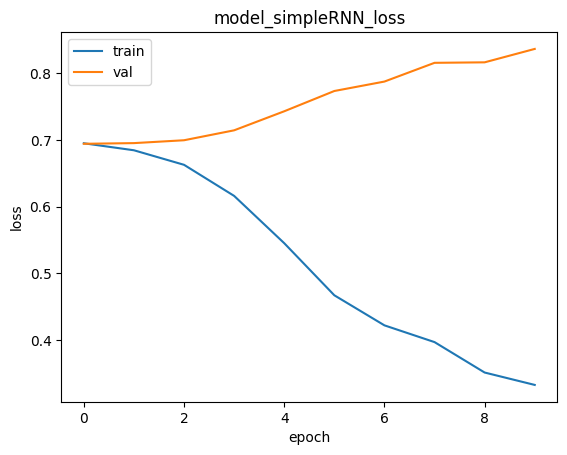

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model_simpleRNN_loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

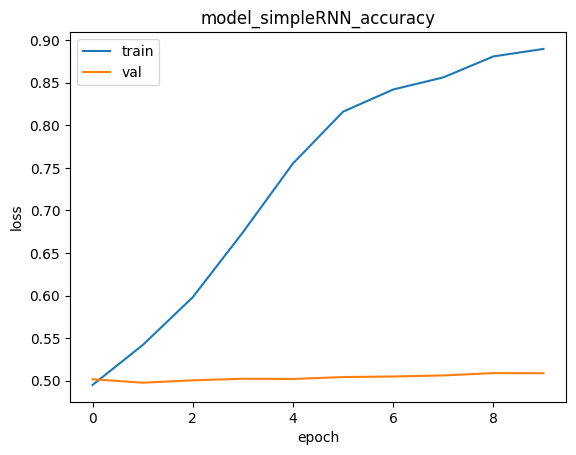

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model_simpleRNN_accuracy')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

### **EVALUATION**

In [ ]:
test_dataset=test_ds.map(vectorizer)
test_dataset=test_dataset.batch(batch_size)
model_simpleRNN.evaluate(test_dataset)

196/196 [==============================] - 6s 30ms/step - loss: 0.8570 - accuracy: 0.4993


[0.8570475578308105, 0.49928000569343567]

## **LSTM (Bidirectional and MultiLayered)**

In [ ]:
embedding_dimension = 64
vocabulary_size = max_tokens
model_lstm_bidirectional = Sequential([
    Input(shape = (sequence_length)),
    Embedding(vocabulary_size, embedding_dimension),

    Bidirectional(LSTM(64, return_sequences = True)),
    Bidirectional(LSTM(32)),

    Dense(64, activation = "relu"),
    Dropout(0.5),
    Dense(1, activation = "sigmoid")
])
model_lstm_bidirectional.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_1 (Embedding)     (None, 250, 64)           640000    
                                                                 
 bidirectional_2 (Bidirecti  (None, 250, 128)          66048     
 onal)                                                           
                                                                 
 bidirectional_3 (Bidirecti  (None, 64)                41216     
 onal)                                                           
                                                                 
 dense_2 (Dense)             (None, 64)                4160      
                                                                 
 dropout_1 (Dropout)         (None, 64)                0         
                                                                 
 dense_3 (Dense)             (None, 1)                

In [ ]:
checkpoint_filepath = '/content/bidirectional_LSTM.h5'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

In [ ]:
model_lstm_bidirectional.compile(loss = tf.keras.losses.BinaryCrossentropy(),
              optimizer = tf.keras.optimizers.Adam(1e-4),
              metrics = ['accuracy'])

In [ ]:
history_lstm = model_lstm_bidirectional.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=10,
    callbacks=[model_checkpoint_callback])

Epoch 1/10
391/391 [==============================] - 380s 944ms/step - loss: 0.6387 - accuracy: 0.6093 - val_loss: 0.4148 - val_accuracy: 0.8189
Epoch 2/10


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


391/391 [==============================] - 305s 781ms/step - loss: 0.3359 - accuracy: 0.8643 - val_loss: 0.3319 - val_accuracy: 0.8627
Epoch 3/10
391/391 [==============================] - 301s 769ms/step - loss: 0.2492 - accuracy: 0.9083 - val_loss: 0.3483 - val_accuracy: 0.8670
Epoch 4/10
391/391 [==============================] - 303s 775ms/step - loss: 0.2052 - accuracy: 0.9301 - val_loss: 0.3955 - val_accuracy: 0.8506
Epoch 5/10
391/391 [==============================] - 304s 778ms/step - loss: 0.1871 - accuracy: 0.9370 - val_loss: 0.3717 - val_accuracy: 0.8569
Epoch 6/10
391/391 [==============================] - 303s 775ms/step - loss: 0.1605 - accuracy: 0.9466 - val_loss: 0.4207 - val_accuracy: 0.8458
Epoch 7/10
391/391 [==============================] - 303s 776ms/step - loss: 0.1345 - accuracy: 0.9590 - val_loss: 0.4553 - val_accuracy: 0.8495
Epoch 8/10
391/391 [==============================] - 303s 775ms/step - loss: 0.1170 - accuracy: 0.9672 - val_loss: 0.5144 - val_accura

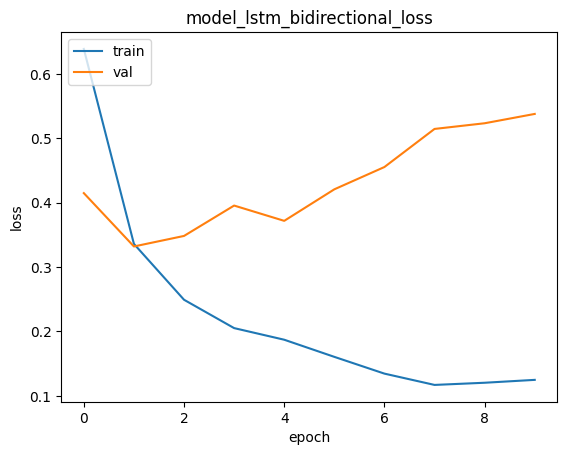

In [ ]:
plt.plot(history_lstm.history['loss'])
plt.plot(history_lstm.history['val_loss'])
plt.title('model_lstm_bidirectional_loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

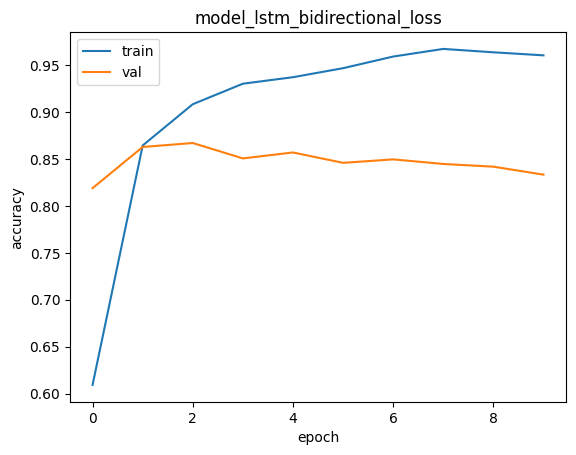

In [ ]:
plt.plot(history_lstm.history['accuracy'])
plt.plot(history_lstm.history['val_accuracy'])
plt.title('model_lstm_bidirectional_loss')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

### **EVALUATION**

In [ ]:
test_dataset=test_ds.map(vectorizer)
test_dataset=test_dataset.batch(batch_size)
model_lstm_bidirectional.evaluate(test_dataset)

196/196 [==============================] - 41s 210ms/step - loss: 0.5436 - accuracy: 0.8317


[0.5436230301856995, 0.8316799998283386]

## **GRU (Bidirectional and Multi Layered)**

In [ ]:
embedding_dimension = 64
vocabulary_size = max_tokens
model_gru = Sequential([
    Input(shape = (sequence_length)),
    Embedding(vocabulary_size, embedding_dimension),

    Bidirectional(GRU(64, return_sequences = True)),
    Bidirectional(GRU(32)),

    Dense(64, activation = "relu"),
    Dropout(0.5),
    Dense(1, activation = "sigmoid")
])
model_gru.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_3 (Embedding)     (None, 250, 64)           640000    
                                                                 
 bidirectional_4 (Bidirecti  (None, 250, 128)          49920     
 onal)                                                           
                                                                 
 bidirectional_5 (Bidirecti  (None, 64)                31104     
 onal)                                                           
                                                                 
 dense_4 (Dense)             (None, 64)                4160      
                                                                 
 dropout_2 (Dropout)         (None, 64)                0         
                                                                 
 dense_5 (Dense)             (None, 1)                

In [ ]:
checkpoint_filepath = '/content/GRU.h5'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

In [ ]:
model_gru.compile(loss = tf.keras.losses.BinaryCrossentropy(),
              optimizer = tf.keras.optimizers.Adam(1e-4),
              metrics = ['accuracy'])

In [ ]:
history_gru = model_gru.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=10,
    callbacks=[model_checkpoint_callback])

Epoch 1/10
391/391 [==============================] - 295s 754ms/step - loss: 0.5656 - accuracy: 0.6961 - val_loss: 0.3659 - val_accuracy: 0.8424


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Epoch 2/10
391/391 [==============================] - 295s 753ms/step - loss: 0.3029 - accuracy: 0.8799 - val_loss: 0.3354 - val_accuracy: 0.8646
Epoch 3/10
391/391 [==============================] - 296s 758ms/step - loss: 0.2368 - accuracy: 0.9122 - val_loss: 0.3751 - val_accuracy: 0.8619
Epoch 4/10
391/391 [==============================] - 294s 754ms/step - loss: 0.2014 - accuracy: 0.9320 - val_loss: 0.4470 - val_accuracy: 0.8482
Epoch 5/10
391/391 [==============================] - 298s 763ms/step - loss: 0.1779 - accuracy: 0.9406 - val_loss: 0.4181 - val_accuracy: 0.8553
Epoch 6/10
391/391 [==============================] - 299s 763ms/step - loss: 0.1603 - accuracy: 0.9455 - val_loss: 0.4633 - val_accuracy: 0.8457
Epoch 7/10
391/391 [==============================] - 300s 767ms/step - loss: 0.1408 - accuracy: 0.9532 - val_loss: 0.4697 - val_accuracy: 0.8422
Epoch 8/10
391/391 [==============================] - 297s 761ms/step - loss: 0.1270 - accuracy: 0.9588 - val_loss: 0.4587 -

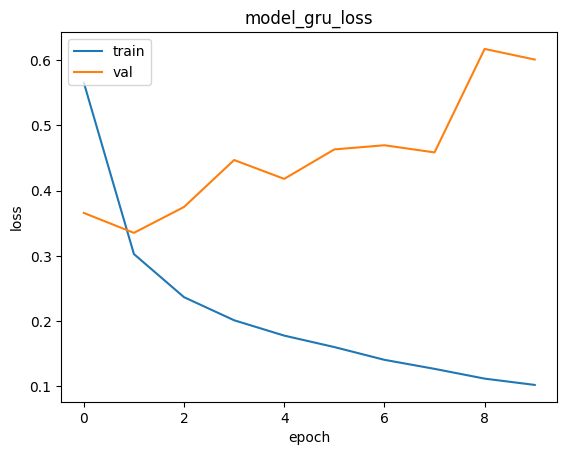

In [ ]:
plt.plot(history_gru.history['loss'])
plt.plot(history_gru.history['val_loss'])
plt.title('model_gru_loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

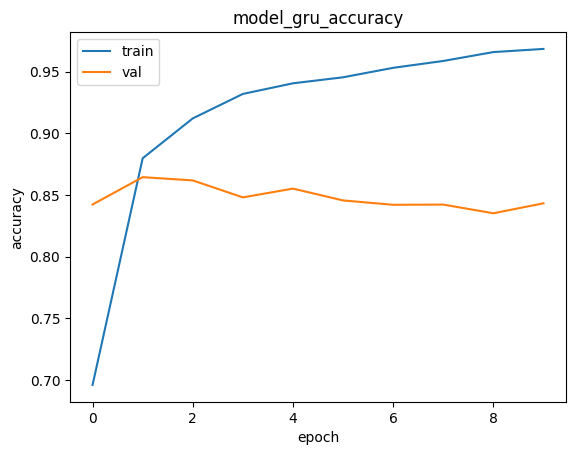

In [ ]:
plt.plot(history_gru.history['accuracy'])
plt.plot(history_gru.history['val_accuracy'])
plt.title('model_gru_accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

### **EVALUATION**

In [ ]:
test_dataset=test_ds.map(vectorizer)
test_dataset=test_dataset.batch(batch_size)
model_gru.evaluate(test_dataset)

196/196 [==============================] - 37s 186ms/step - loss: 0.5964 - accuracy: 0.8424


[0.5963842272758484, 0.8424000144004822]

## **1D Convolutional Layer**

In [ ]:
embedding_dimension = 64
vocabulary_size = max_tokens
model_conv1d = Sequential([
    Input(shape = (sequence_length)),
    Embedding(vocabulary_size, embedding_dimension),

    Conv1D(32, 3, activation = "relu"),
    Flatten(),

    Dense(64, activation = "relu"),
    Dropout(0.5),
    Dense(1, activation = "sigmoid")
])
model_conv1d.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 250, 64)           640000    
                                                                 
 conv1d (Conv1D)             (None, 248, 32)           6176      
                                                                 
 flatten (Flatten)           (None, 7936)              0         
                                                                 
 dense (Dense)               (None, 64)                507968    
                                                                 
 dropout (Dropout)           (None, 64)                0         
                                                                 
 dense_1 (Dense)             (None, 1)                 65        
                                                                 
Total params: 1154209 (4.40 MB)
Trainable params: 115420

In [ ]:
checkpoint_filepath = '/content/conv1D.h5'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

In [ ]:
model_conv1d.compile(loss = tf.keras.losses.BinaryCrossentropy(),
              optimizer = tf.keras.optimizers.Adam(1e-4),
              metrics = ['accuracy'])

In [ ]:
history_conv1d = model_conv1d.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=10,
    callbacks=[model_checkpoint_callback])

Epoch 1/10
391/391 [==============================] - 28s 64ms/step - loss: 0.6927 - accuracy: 0.5095 - val_loss: 0.6891 - val_accuracy: 0.5683


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Epoch 2/10
391/391 [==============================] - 26s 65ms/step - loss: 0.5803 - accuracy: 0.7036 - val_loss: 0.3945 - val_accuracy: 0.8347
Epoch 3/10
391/391 [==============================] - 34s 88ms/step - loss: 0.3141 - accuracy: 0.8734 - val_loss: 0.3163 - val_accuracy: 0.8685
Epoch 4/10
391/391 [==============================] - 30s 76ms/step - loss: 0.2346 - accuracy: 0.9112 - val_loss: 0.3114 - val_accuracy: 0.8691
Epoch 5/10
391/391 [==============================] - 34s 88ms/step - loss: 0.1896 - accuracy: 0.9322 - val_loss: 0.3240 - val_accuracy: 0.8658
Epoch 6/10
391/391 [==============================] - 24s 61ms/step - loss: 0.1598 - accuracy: 0.9456 - val_loss: 0.3439 - val_accuracy: 0.8614
Epoch 7/10
391/391 [==============================] - 26s 66ms/step - loss: 0.1354 - accuracy: 0.9577 - val_loss: 0.3703 - val_accuracy: 0.8603
Epoch 8/10
391/391 [==============================] - 25s 65ms/step - loss: 0.1138 - accuracy: 0.9668 - val_loss: 0.4031 - val_accuracy:

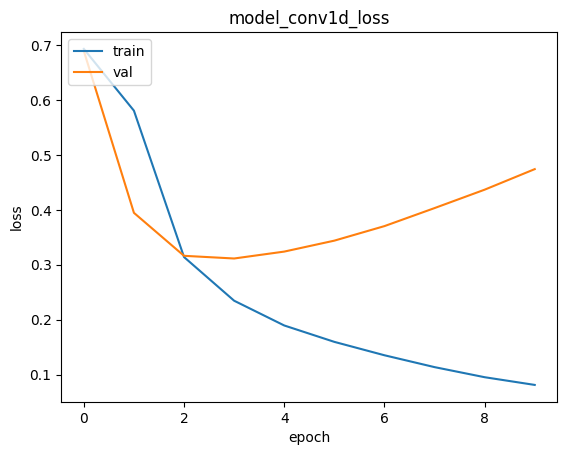

In [ ]:
plt.plot(history_conv1d.history['loss'])
plt.plot(history_conv1d.history['val_loss'])
plt.title('model_conv1d_loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

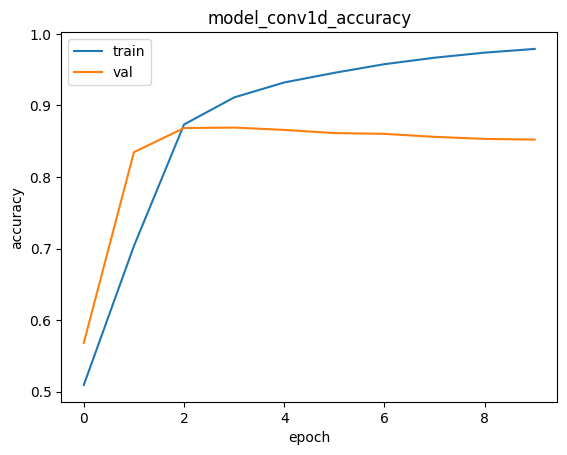

In [ ]:
plt.plot(history_conv1d.history['accuracy'])
plt.plot(history_conv1d.history['val_accuracy'])
plt.title('model_conv1d_accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

### **EVALUATION**

In [ ]:
test_dataset=test_ds.map(vectorizer)
test_dataset=test_dataset.batch(batch_size)
model_conv1d.evaluate(test_dataset)

196/196 [==============================] - 9s 43ms/step - loss: 0.4681 - accuracy: 0.8502


[0.46811121702194214, 0.8501600027084351]

## **Pretrained Word2Vec (Gensim)**

In [ ]:
word2vec = api.load('word2vec-google-news-300')

[==================================================] 100.0% 1662.8/1662.8MB downloaded


In [ ]:
word2vec

In [ ]:
word2vec.vectors.shape

(3000000, 300)

So, Vocabulary size = 3000000, embedding dimension = 300

In [ ]:
word2vec.key_to_index #Gives output in the form of a dictionary
#word2vec.index_to_key #Gives output in the form of a list

{'</s>': 0,
 'in': 1,
 'for': 2,
 'that': 3,
 'is': 4,
 'on': 5,
 '##': 6,
 'The': 7,
 'with': 8,
 'said': 9,
 'was': 10,
 'the': 11,
 'at': 12,
 'not': 13,
 'as': 14,
 'it': 15,
 'be': 16,
 'from': 17,
 'by': 18,
 'are': 19,
 'I': 20,
 'have': 21,
 'he': 22,
 'will': 23,
 'has': 24,
 '####': 25,
 'his': 26,
 'an': 27,
 'this': 28,
 'or': 29,
 'their': 30,
 'who': 31,
 'they': 32,
 'but': 33,
 '$': 34,
 'had': 35,
 'year': 36,
 'were': 37,
 'we': 38,
 'more': 39,
 '###': 40,
 'up': 41,
 'been': 42,
 'you': 43,
 'its': 44,
 'one': 45,
 'about': 46,
 'would': 47,
 'which': 48,
 'out': 49,
 'can': 50,
 'It': 51,
 'all': 52,
 'also': 53,
 'two': 54,
 'after': 55,
 'first': 56,
 'He': 57,
 'do': 58,
 'time': 59,
 'than': 60,
 'when': 61,
 'We': 62,
 'over': 63,
 'last': 64,
 'new': 65,
 'other': 66,
 'her': 67,
 'people': 68,
 'into': 69,
 'In': 70,
 'our': 71,
 'there': 72,
 'A': 73,
 'she': 74,
 'could': 75,
 'just': 76,
 'years': 77,
 'some': 78,
 'U.S.': 79,
 'three': 80,
 'million': 81

In [ ]:
word2vec['The'] #1D embedding array of shape (300,)

array([-0.17285156,  0.27929688,  0.10693359, -0.15820312, -0.08447266,
        0.05908203,  0.04077148,  0.00254822,  0.25976562,  0.18066406,
        0.09765625, -0.08105469, -0.01049805,  0.09814453,  0.00060272,
        0.07080078, -0.015625  , -0.09521484, -0.08105469, -0.02868652,
       -0.03320312,  0.16503906,  0.03979492, -0.03710938,  0.04101562,
       -0.12695312, -0.12890625,  0.12353516,  0.04980469,  0.01257324,
        0.05786133, -0.00830078, -0.02832031, -0.03320312,  0.16113281,
        0.07519531, -0.25976562,  0.08935547,  0.13574219,  0.00460815,
       -0.04418945,  0.02319336, -0.10449219, -0.05151367,  0.08349609,
       -0.02050781, -0.02172852, -0.02734375,  0.16015625,  0.19042969,
       -0.0324707 ,  0.06787109,  0.10302734, -0.25390625,  0.00634766,
        0.20507812,  0.02111816, -0.21679688, -0.02441406,  0.17089844,
       -0.21875   ,  0.10009766, -0.15527344, -0.12597656, -0.03833008,
       -0.05419922,  0.19238281,  0.21777344,  0.12109375, -0.02

In [ ]:
word2vec.most_similar('Man')

[('Woman', 0.6939345002174377),
 ('Boy', 0.5896925330162048),
 ('Girl', 0.584598958492279),
 ('Suspect', 0.5577560067176819),
 ('Couple', 0.5528685450553894),
 ('man', 0.5316051840782166),
 ('Robber', 0.5315312743186951),
 ('Teenager', 0.5161930322647095),
 ('depicts_Michelangelo_Creation', 0.5148172378540039),
 ('Policeman', 0.5136396884918213)]

In [ ]:
word2vec.most_similar('Woman')

[('Man', 0.6939343810081482),
 ('Couple', 0.6447763442993164),
 ('Girl', 0.630740225315094),
 ('Suspect', 0.597058892250061),
 ('Toddler', 0.5857008099555969),
 ('Teenager', 0.5854460000991821),
 ('Teen', 0.5807650089263916),
 ('woman', 0.5770983695983887),
 ('Mother', 0.5710680484771729),
 ('Widow', 0.5678656697273254)]

We see some bias here as the word robber is associated with man but not woman

In [ ]:
def first_caps(word):
  return word[0].upper()+word[1:]

In [ ]:
pretrained_embeddings=[]
embedding_dimension = 300 #Gensim embedding dimension
count_no_solution = 0
for i in range(len(vectorization_layer.get_vocabulary())):
  try:
    pretrained_embeddings.append(word2vec[vectorization_layer.get_vocabulary()[i]]) #Appending embedding if word present
  except:
    try:
      pretrained_embeddings.append(word2vec[first_caps(vectorization_layer.get_vocabulary()[i])]) #Appending embedding if first_caps(word) is present
    except:
      print(vectorization_layer.get_vocabulary()[i],' nosolution')
      count_no_solution += 1
      pretrained_embeddings.append(random.normal(loc=0, scale=1, size=(embedding_dimension))) #Randomly initialize their embedding if word not present in gensim vocabulary

  if i%1000==0: #For checking progress
    print('========================================',i)

print(count_no_solution)

  nosolution
======================================== 0
[UNK]  nosolution
doesnt  nosolution
didnt  nosolution
isnt  nosolution
wasnt  nosolution
10  nosolution
80s  nosolution
20  nosolution
70s  nosolution
======================================== 1000
15  nosolution
12  nosolution
30  nosolution
100  nosolution
hasnt  nosolution
90  nosolution
shouldnt  nosolution
60s  nosolution
40  nosolution
lowbudget  nosolution
50  nosolution
90s  nosolution
1950s  nosolution
======================================== 2000
50s  nosolution
1010  nosolution
11  nosolution
1970s  nosolution
overthetop  nosolution
1980s  nosolution
25  nosolution
1930s  nosolution
14  nosolution
13  nosolution
bmovie  nosolution
moviethe  nosolution
writerdirector  nosolution
itthe  nosolution
810  nosolution
======================================== 3000
30s  nosolution
filmthe  nosolution
2006  nosolution
1960s  nosolution
2000  nosolution
110  nosolution
wwii  nosolution
710  nosolution
mst3k  nosolution
2001  nosol

In [ ]:
pretrained_embeddings_array = np.array(pretrained_embeddings)
print(pretrained_embeddings_array.shape)

(10000, 300)


In [ ]:
np.save('/content/pretrained_embeddings', pretrained_embeddings_array)
pretrained_embeddings_array = np.load('/content/pretrained_embeddings.npy')
print(pretrained_embeddings_array.shape)

(10000, 300)


In [ ]:
embedding_dimension = 300
vocabulary_size = max_tokens
model_gensim_conv1d = Sequential([
    Input(shape = (sequence_length)),
    Embedding(vocabulary_size, embedding_dimension,
              embeddings_initializer = tf.keras.initializers.Constant(pretrained_embeddings_array),
              trainable = True),

    Conv1D(32, 3, activation = "relu"),
    Flatten(),

    Dense(64, activation = "relu"),
    Dropout(0.5),
    Dense(1, activation = "sigmoid")
])
model_gensim_conv1d.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 250, 300)          3000000   
                                                                 
 conv1d (Conv1D)             (None, 248, 32)           28832     
                                                                 
 flatten (Flatten)           (None, 7936)              0         
                                                                 
 dense (Dense)               (None, 64)                507968    
                                                                 
 dropout (Dropout)           (None, 64)                0         
                                                                 
 dense_1 (Dense)             (None, 1)                 65        
                                                                 
Total params: 3536865 (13.49 MB)
Trainable params: 35368

In [ ]:
checkpoint_filepath = '/content/gensim_conv1d.h5'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

In [ ]:
model_gensim_conv1d.compile(loss = tf.keras.losses.BinaryCrossentropy(),
              optimizer = tf.keras.optimizers.Adam(1e-4),
              metrics = ['accuracy'])

In [ ]:
history_gensim_conv1d = model_gensim_conv1d.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=10,
    callbacks=[model_checkpoint_callback])

Epoch 1/10
391/391 [==============================] - ETA: 0s - loss: 0.6958 - accuracy: 0.5112

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


391/391 [==============================] - 117s 293ms/step - loss: 0.6958 - accuracy: 0.5112 - val_loss: 0.6917 - val_accuracy: 0.5206
Epoch 2/10
391/391 [==============================] - 84s 215ms/step - loss: 0.6630 - accuracy: 0.5898 - val_loss: 0.5542 - val_accuracy: 0.7434
Epoch 3/10
391/391 [==============================] - 78s 200ms/step - loss: 0.4195 - accuracy: 0.8147 - val_loss: 0.3687 - val_accuracy: 0.8381
Epoch 4/10
391/391 [==============================] - 78s 200ms/step - loss: 0.3072 - accuracy: 0.8745 - val_loss: 0.3312 - val_accuracy: 0.8576
Epoch 5/10
391/391 [==============================] - 78s 198ms/step - loss: 0.2520 - accuracy: 0.9010 - val_loss: 0.3191 - val_accuracy: 0.8656
Epoch 6/10
391/391 [==============================] - 89s 229ms/step - loss: 0.2101 - accuracy: 0.9219 - val_loss: 0.3186 - val_accuracy: 0.8670
Epoch 7/10
391/391 [==============================] - 93s 238ms/step - loss: 0.1738 - accuracy: 0.9378 - val_loss: 0.3273 - val_accuracy: 0.

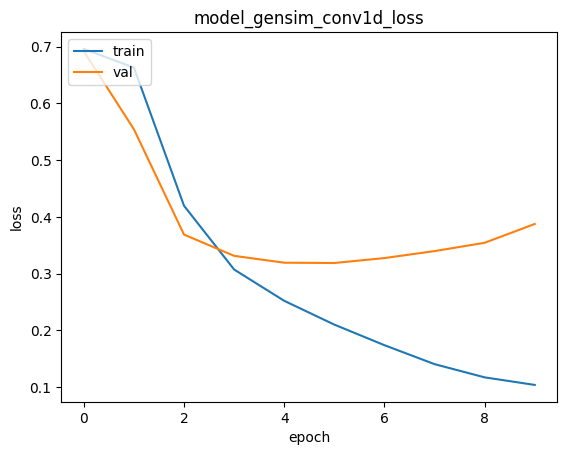

In [ ]:
plt.plot(history_gensim_conv1d.history['loss'])
plt.plot(history_gensim_conv1d.history['val_loss'])
plt.title('model_gensim_conv1d_loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

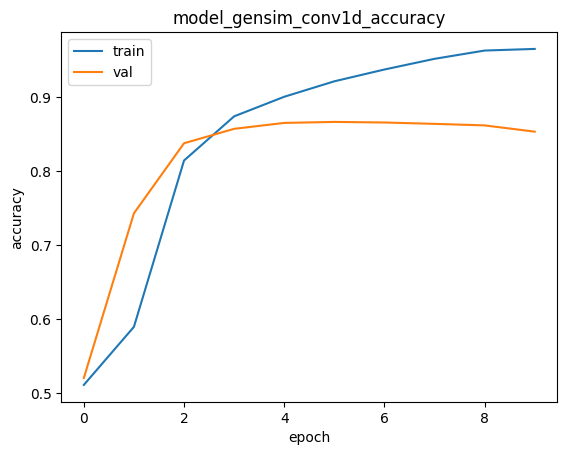

In [ ]:
plt.plot(history_gensim_conv1d.history['accuracy'])
plt.plot(history_gensim_conv1d.history['val_accuracy'])
plt.title('model_gensim_conv1d_accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

### **EVALUATION**

In [ ]:
test_dataset=test_ds.map(vectorizer)
test_dataset=test_dataset.batch(batch_size)
model_gensim_conv1d.evaluate(test_dataset)

196/196 [==============================] - 10s 51ms/step - loss: 0.3946 - accuracy: 0.8540


[0.39457646012306213, 0.8539999723434448]

Generally does better than training our own embeddings

# **TESTING**

In [ ]:
test_data=tf.data.Dataset.from_tensor_slices([["this movie looks very interesting, i love the fact that the actors do a great job in showing how people lived in the 18th century, which wasn't very good at all. But atleast this movie recreates this scenes! "],
                                              ["very good start, but movie started becoming interesting at some point and fortunately at some point it started becoming much more fun, so in all i liked this movie "],])


In [ ]:
def vectorizer_test(review):
    return vectorization_layer(review)
test_dataset=test_data.map(vectorizer_test)

In [ ]:
model_gensim_conv1d.predict(test_dataset)

2/2 [==============================] - 0s 6ms/step


array([[0.53012234],
       [0.68370765]], dtype=float32)

## **Inference Ready Testing**

In [ ]:
inputs = Input(shape = (1), dtype = "string")
vectorized_inputs = vectorization_layer(inputs)
outputs = model_gensim_conv1d(vectorized_inputs)

inference_model = tf.keras.Model(inputs, outputs)
inference_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 1)]               0         
                                                                 
 text_vectorization (TextVe  (None, 250)               0         
 ctorization)                                                    
                                                                 
 sequential (Sequential)     (None, 1)                 3536865   
                                                                 
Total params: 3536865 (13.49 MB)
Trainable params: 3536865 (13.49 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
inference_model.predict(["this movie looks very interesting, i love the fact that the actors do a great job in showing how people lived in the 18th century, which wasn't very good at all. But atleast this movie recreates this scenes! ",
                               "very good start, but movie started becoming interesting at some point and fortunately at some point it started becoming much more fun, so in all i liked this movie "])

1/1 [==============================] - 0s 61ms/step


array([[0.53012234],
       [0.68370765]], dtype=float32)

# **VISUALIZING EMBEDDINGS**

In [ ]:
embedding_dimension = 300
vocabulary_size = max_tokens
model = Sequential([
    Input(shape = (sequence_length)),
    Embedding(vocabulary_size, embedding_dimension),

    Conv1D(32, 3, activation = "relu"),
    Flatten(),

    Dense(64, activation = "relu"),
    Dropout(0.5),
    Dense(1, activation = "sigmoid")
])
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_2 (Embedding)     (None, 250, 300)          3000000   
                                                                 
 conv1d_2 (Conv1D)           (None, 248, 32)           28832     
                                                                 
 flatten_2 (Flatten)         (None, 7936)              0         
                                                                 
 dense_4 (Dense)             (None, 64)                507968    
                                                                 
 dropout_2 (Dropout)         (None, 64)                0         
                                                                 
 dense_5 (Dense)             (None, 1)                 65        
                                                                 
Total params: 3536865 (13.49 MB)
Trainable params: 353

In [ ]:
model.compile(loss = tf.keras.losses.BinaryCrossentropy(),
              optimizer = tf.keras.optimizers.Adam(1e-4),
              metrics = ['accuracy'])

In [ ]:
log_dir = 'logs/imdb/fit/'+datetime.datetime.now().strftime("%Y%m%d-%H%M%S")+'/'

In [ ]:
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir, histogram_freq = 1)

In [ ]:
history = model.fit(
    train_dataset,
    validation_data = val_dataset,
    epochs = 6,
    callbacks = [tensorboard_callback])

Epoch 1/6
391/391 [==============================] - 79s 197ms/step - loss: 0.6914 - accuracy: 0.5214 - val_loss: 0.6829 - val_accuracy: 0.5593
Epoch 2/6
391/391 [==============================] - 73s 186ms/step - loss: 0.4911 - accuracy: 0.7709 - val_loss: 0.3392 - val_accuracy: 0.8558
Epoch 3/6
391/391 [==============================] - 72s 184ms/step - loss: 0.2673 - accuracy: 0.8969 - val_loss: 0.3100 - val_accuracy: 0.8707
Epoch 4/6
391/391 [==============================] - 74s 190ms/step - loss: 0.2019 - accuracy: 0.9268 - val_loss: 0.3257 - val_accuracy: 0.8642
Epoch 5/6
391/391 [==============================] - 111s 284ms/step - loss: 0.1597 - accuracy: 0.9462 - val_loss: 0.3468 - val_accuracy: 0.8619
Epoch 6/6
391/391 [==============================] - 107s 275ms/step - loss: 0.1262 - accuracy: 0.9606 - val_loss: 0.3821 - val_accuracy: 0.8577


In [ ]:
with open(os.path.join(log_dir, 'meta_data.tsv'), 'w', encoding = "utf-8") as f:
  for i in range(vocabulary_size):
    f.write("{} {}\n".format(i, vectorization_layer.get_vocabulary()[i]))

In [ ]:
embedding_weights = tf.Variable(model.layers[0].get_weights()[0]) #Embedding layer weights
print(embedding_weights.shape)

(10000, 300)


In [ ]:
from tensorboard.plugins import projector
checkpoint=tf.train.Checkpoint(embedding=embedding_weights)
checkpoint.save(os.path.join(log_dir,"embedding.ckpt"))

config=projector.ProjectorConfig()
embedding=config.embeddings.add()

In [ ]:
embedding.metadata_path='metadata.tsv'
projector.visualize_embeddings(log_dir,config)

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir logs/imdb/fit/

<IPython.core.display.Javascript object>